# High Mountain Asia UCLA Daily Snow Reanalysis, Version 1
Snowpack plays a significant role in the hydrologic cycle over High Mountain Asia (HMA). As a vital water resource, the distribution of snowpack volume also impacts the water availability for downstream populations. To assess the regional water balance, it is important to characterize the spatio-temporal distribution of water storage in the HMA snowpack.
This HMA snow reanalysis data set contains daily estimates of posterior snow water equivalent (SWE), fractional snow covered area (fSCA), snow depth (SD), etc.

https://nsidc.org/data/HMA_SR_D/versions/1

/!\ non seasonal snow may be not reliable because of snow scheme /!\

Stats:  ensemble mean, ensemble standard deviation, ensemble median, 25th percentile, and 75th percentile

Download 24/06/2021

In [1]:
# To reload external files automatically (ex: utils)
%load_ext autoreload
%autoreload 2

import xarray as xr
import pandas as pd
import numpy as np
import calendar as cld
import matplotlib.pyplot as plt
import proplot as plot # New plot library (https://proplot.readthedocs.io/en/latest/)
plot.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures
from scipy import stats
import xesmf as xe # For regridding (https://xesmf.readthedocs.io/en/latest/)

import sys
# sys.path.insert(1, '/home/mlalande/notebooks/utils') # to include my util file in previous directory
sys.path.insert(1, '/home/lalandmi/Dropbox/Thèse/notebooks/utils') # to include my util file in previous directory
import utils as u # my personal functions
u.check_python_version()
# u.check_virtual_memory()

3.8.5 | packaged by conda-forge | (default, Jul 24 2020, 01:25:15) 
[GCC 7.5.0]


## Try with few tiles (1°x1°)

In [2]:
path = '/home/lalandmi/Dropbox/data/HMA_UCLA_Reanalysis/'

### Load sd, swe and sca

In [3]:
ds = xr.open_mfdataset('/home/lalandmi/Dropbox/data/HMA_UCLA_Reanalysis/5000001147190/*/HMA_SR_D_v01_N*E*_agg_16_WY1999_00_SD_POST.nc')
# ds = xr.open_dataset(path+'5000001147190/210524848/HMA_SR_D_v01_N36_0E74_0_agg_16_WY1999_00_SD_POST.nc')

# Add time coordinates (time starts 1rst october)
ds = ds.assign_coords(Day=pd.date_range(start='1999-10-01', periods=ds.Day.size, freq='D'))
sd = ds.SD_Post.isel(Stats=0).rename({'Longitude': 'lon', 'Latitude': 'lat', 'Day': 'time'}).transpose("time", "lat", "lon")

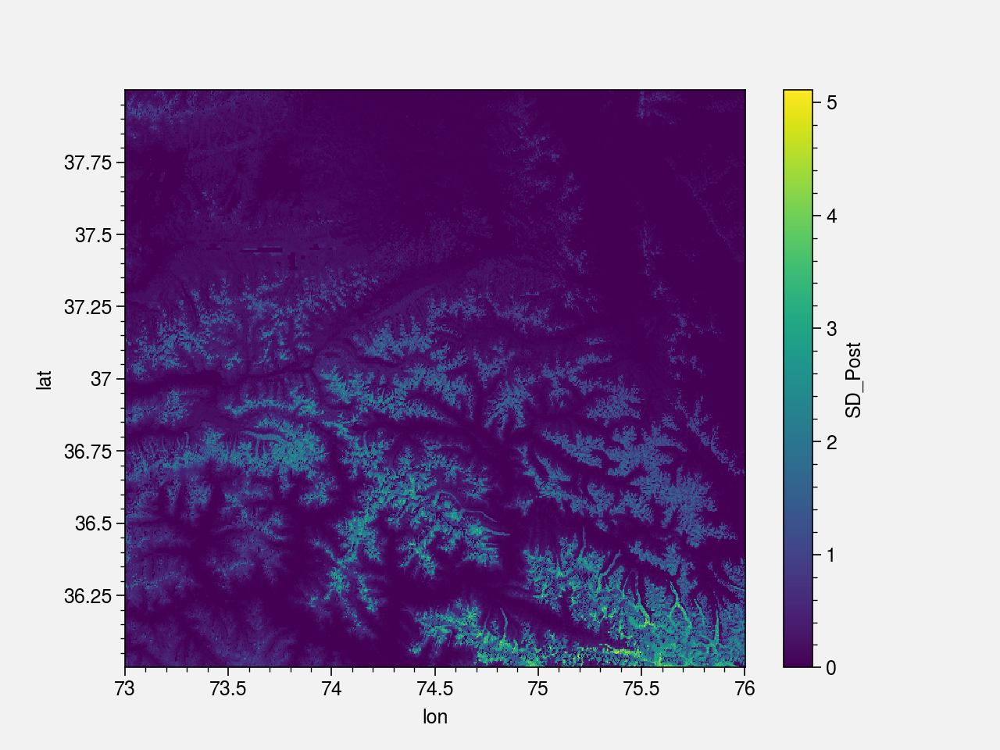

In [4]:
sd.mean('time').plot()

In [4]:
ds = xr.open_mfdataset('/home/lalandmi/Dropbox/data/HMA_UCLA_Reanalysis/5000001147190/*/HMA_SR_D_v01_N*E*_agg_16_WY1999_00_SWE_SCA_POST.nc')
# ds = xr.open_dataset(path+'5000001147190/210524848/HMA_SR_D_v01_N36_0E74_0_agg_16_WY1999_00_SWE_SCA_POST.nc')

ds = ds.assign_coords(Day=pd.date_range(start='1999-10-01', periods=ds.Day.size, freq='D'))

swe = ds.SWE_Post.isel(Stats=0).rename({'Longitude': 'lon', 'Latitude': 'lat', 'Day': 'time'}).transpose("time", "lat", "lon")
scf = ds.SCA_Post.isel(Stats=0).rename({'Longitude': 'lon', 'Latitude': 'lat', 'Day': 'time'}).transpose("time", "lat", "lon")

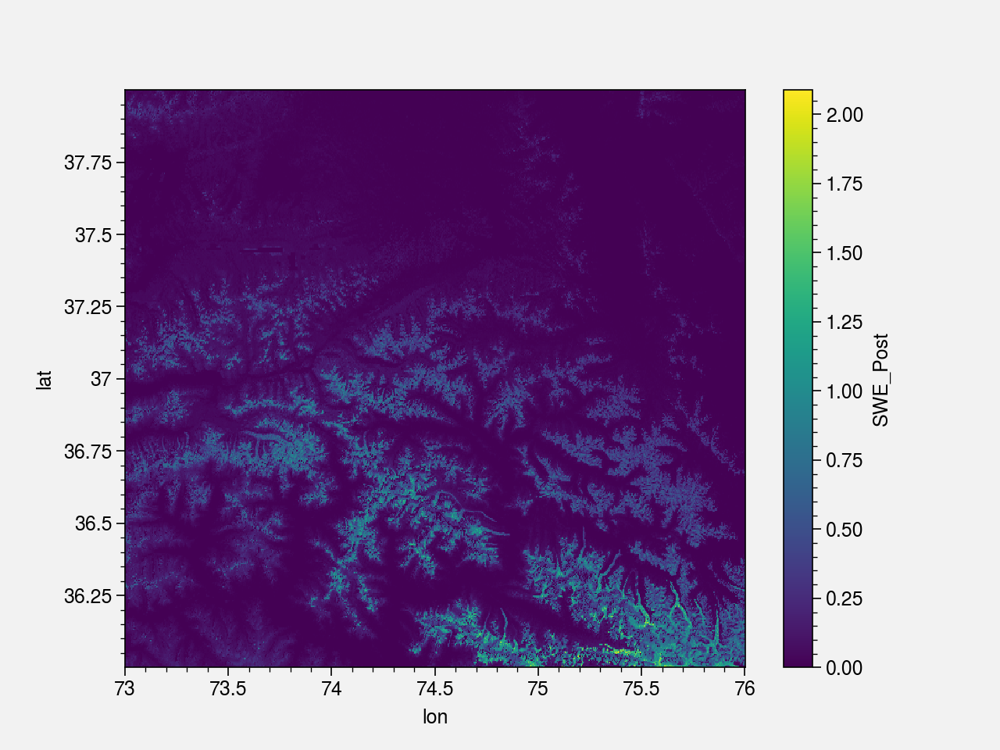

In [6]:
swe.mean('time').plot()

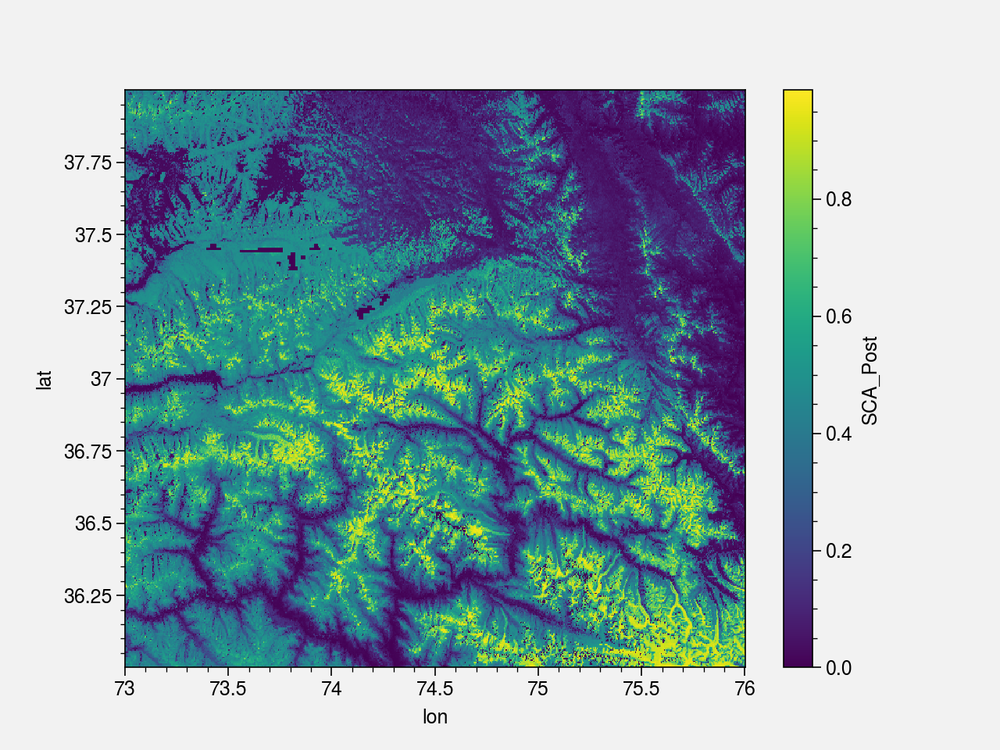

In [7]:
# Des valeurs bizarres à 0... probablement du à la classification 1 et/ou endroits de non seasonal snow
# Je vais tout garder mais à garder en tête que c'est pas parfait et qu'il y a des artefacts !
scf.mean('time').plot()

### Coarsen values to 0.2° (~20km)

In [5]:
sd_20km = sd.coarsen(lat=45, lon=45).mean().load()
swe_20km = swe.coarsen(lat=45, lon=45).mean().load()
scf_20km = scf.coarsen(lat=45, lon=45).mean().load()

In [8]:
plots = [scf.mean('time')*100, sd.mean('time'), swe.mean('time'), scf_20km.mean('time')*100, sd_20km.mean('time'), swe_20km.mean('time')]

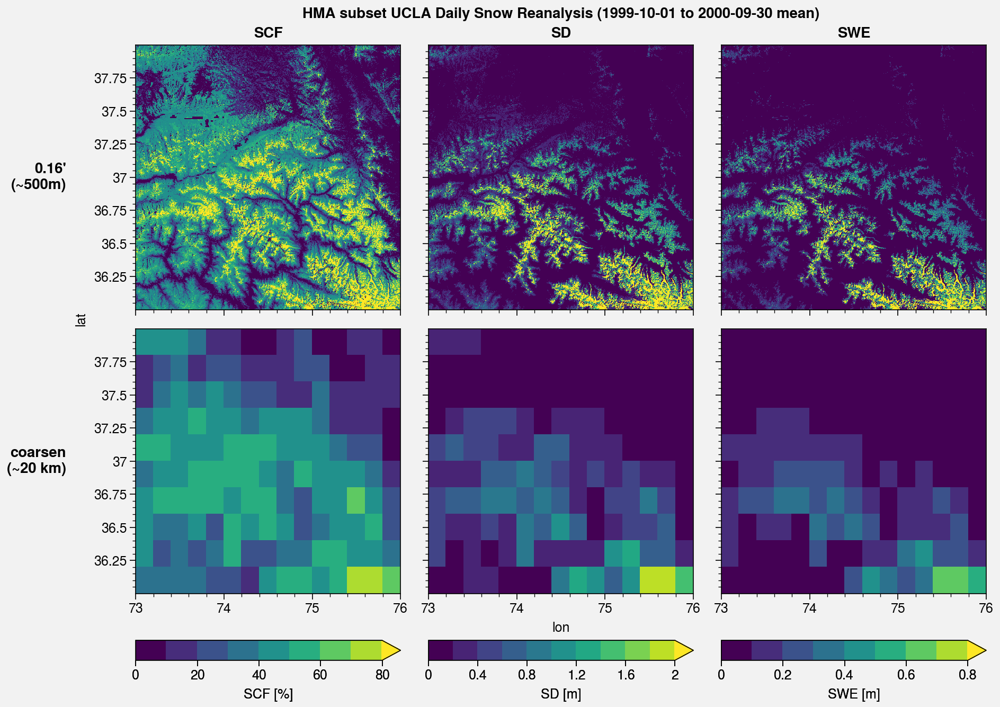

In [9]:
levels = [plot.arange(0,80,10), plot.arange(0,2,0.2), plot.arange(0,0.8,0.1)]*2
labels = ['SCF [%]', 'SD [m]', 'SWE [m]']*2

fig, axs = plot.subplots(nrows=2, ncols=3)

for i, ax in enumerate(axs):
    m = ax.pcolormesh(plots[i], levels=levels[i], cmap='viridis', extend='max')
    if i > 2:
        ax.colorbar(m, loc='b', label=labels[i])

axs.format(
    collabels=['SCF', 'SD', 'SWE'],
    rowlabels=["0.16'\n(~500m)", 'coarsen\n(~20 km)'],
    suptitle='HMA subset UCLA Daily Snow Reanalysis (1999-10-01 to 2000-09-30 mean)'
)

# fig.save('img/1999-2000_subset_HMA_UCLA_coarsen.jpg')

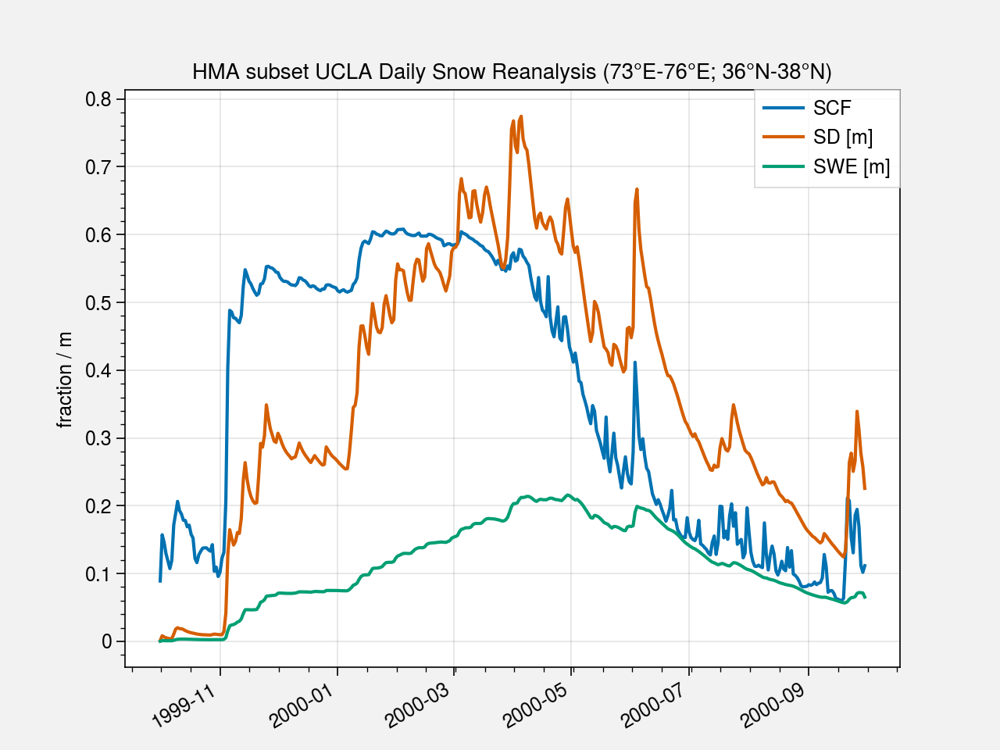

In [10]:
plt.figure()

scf_20km.mean(('lat', 'lon')).plot(label='SCF')
sd_20km.mean(('lat', 'lon')).plot(label='SD [m]')
swe_20km.mean(('lat', 'lon')).plot(label='SWE [m]')

plt.ylabel('fraction / m')
plt.xlabel('')
plt.title('HMA subset UCLA Daily Snow Reanalysis (73°E-76°E; 36°N-38°N)')

plt.legend()

plt.savefig('img/1999-2000_subset_timeseries_HMA_UCLA.jpg')

## Load topo 

In [6]:
latlim, lonlim = u.get_domain_HMA()
root_data_path = '/home/lalandmi/Dropbox/data/' # local
latlim_ext, lonlim_ext = slice(latlim.start-5, latlim.stop+5), slice(lonlim.start-5, lonlim.stop+5)

ds = xr.open_dataset(root_data_path+'GMTED2010/GMTED2010_15n060_0250deg.nc').drop_dims('nbounds').swap_dims(
    {'nlat': 'latitude', 'nlon': 'longitude'}).drop({'nlat', 'nlon'}).rename(
    {'latitude': 'lat', 'longitude': 'lon'}).sel(lat=latlim_ext, lon=lonlim_ext)
elevation = ds.elevation
elevation_std = ds.elevation_stddev

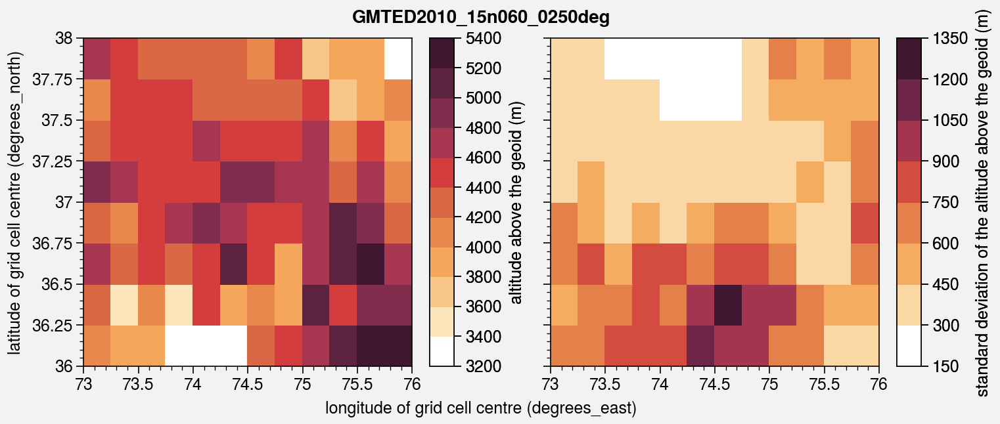

In [16]:
fig, axs = plot.subplots(ncols=2)

axs[0].pcolormesh(elevation.sel(lon=slice(sd.lon.min(),sd.lon.max()), lat=slice(sd.lat.min(),sd.lat.max())), colorbar='r')
axs[1].pcolormesh(elevation_std.sel(lon=slice(sd.lon.min(),sd.lon.max()), lat=slice(sd.lat.min(),sd.lat.max())), colorbar='r')

axs.format(suptitle='GMTED2010_15n060_0250deg')

fig.save('img/elevation_std_subset.jpg')

In [7]:
elevation_subset = elevation.sel(lon=slice(sd.lon.min(),sd.lon.max()), lat=slice(sd.lat.min(),sd.lat.max()))
elevation_std_subset = elevation_std.sel(lon=slice(sd.lon.min(),sd.lon.max()), lat=slice(sd.lat.min(),sd.lat.max()))

## Regrid

In [8]:
regridder = xe.Regridder(sd_20km, elevation_subset, 'bilinear', periodic=False, reuse_weights=True)
sd_regrid = regridder(sd_20km)
swe_regrid = regridder(swe_20km)
scf_regrid = regridder(scf_20km)

Reuse existing file: bilinear_10x15_8x12.nc


In [19]:
plots = [scf_20km.mean('time')*100, sd_20km.mean('time'), swe_20km.mean('time'), scf_regrid.mean('time')*100, sd_regrid.mean('time'), swe_regrid.mean('time')]

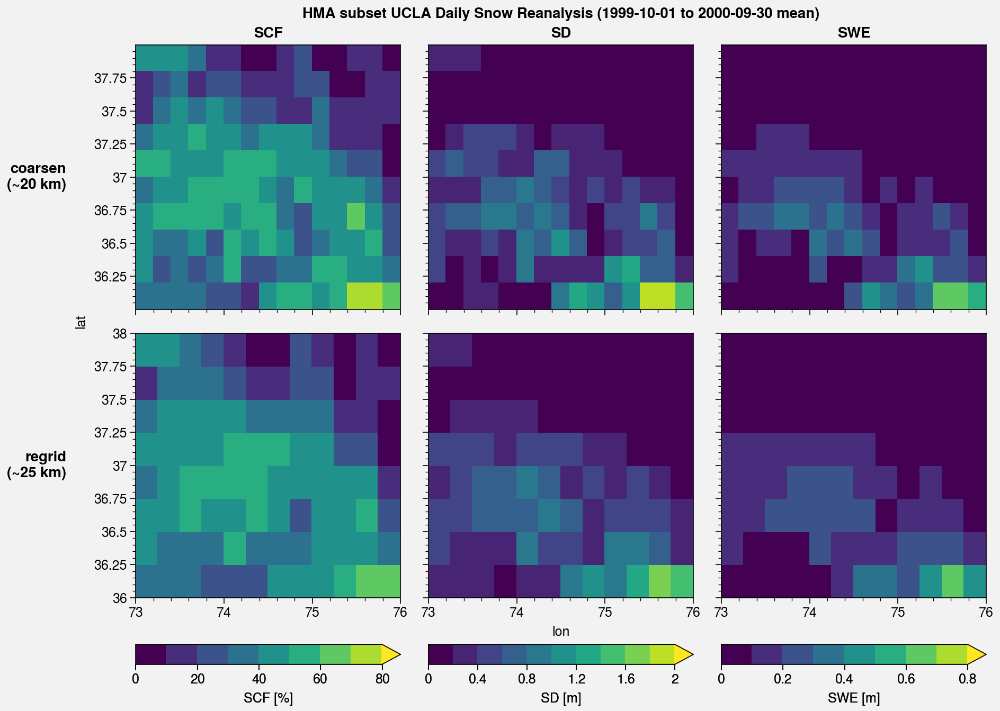

In [20]:
levels = [plot.arange(0,80,10), plot.arange(0,2,0.2), plot.arange(0,0.8,0.1)]*2
labels = ['SCF [%]', 'SD [m]', 'SWE [m]']*2

fig, axs = plot.subplots(nrows=2, ncols=3)

for i, ax in enumerate(axs):
    m = ax.pcolormesh(plots[i], levels=levels[i], cmap='viridis', extend='max')
    if i > 2:
        ax.colorbar(m, loc='b', label=labels[i])

axs.format(
    collabels=['SCF', 'SD', 'SWE'],
    rowlabels=["coarsen\n(~20 km)", "regrid\n(~25 km)"],
    suptitle='HMA subset UCLA Daily Snow Reanalysis (1999-10-01 to 2000-09-30 mean)'
)

## Check SCF/SWE relationship

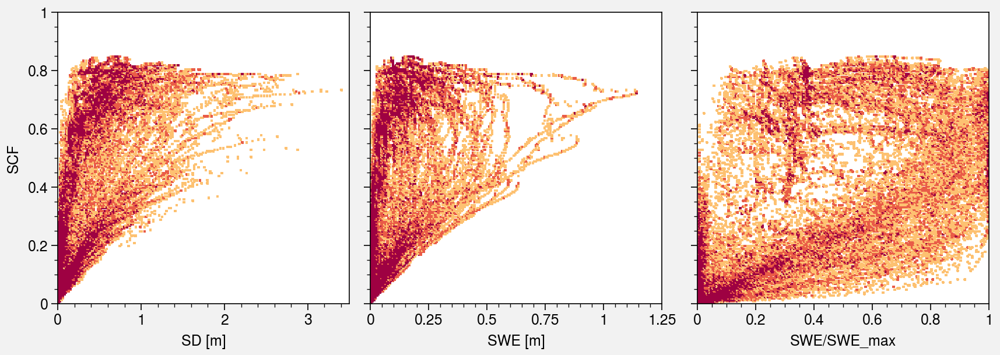

In [39]:
x = scf_regrid.values.flatten()
y = [sd_regrid.values.flatten(), swe_regrid.values.flatten(), (swe_regrid/swe_regrid.max('time')).values.flatten()]

bins = 200
cmap = 'Spectral_r'
norm = 'log'
vmin=1
cmin=1
xylim = [[[0, 3.5], [0, 1]], [[0, 1.25], [0, 1]], [[0, 1], [0, 1]]]
xlabel = ['SD [m]', 'SWE [m]', 'SWE/SWE_max']

fig, axs = plot.subplots(ncols=3, sharex=0)

for i, ax in enumerate(axs):
    ax.hist2d(y[i], x, bins=bins, range=xylim[i], cmap=cmap, norm=norm, vmin=vmin, cmin=cmin)
    ax.format(ylabel='SCF', xlabel=xlabel[i])

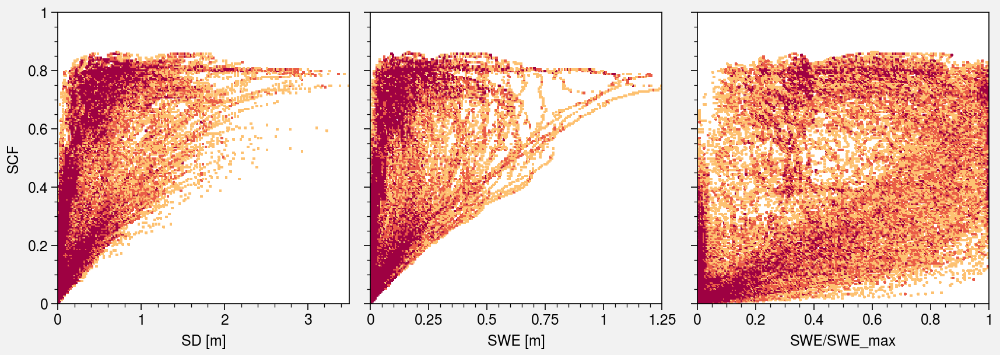

In [40]:
x = scf_20km.values.flatten()
y = [sd_20km.values.flatten(), swe_20km.values.flatten(), (swe_20km/swe_20km.max('time')).values.flatten()]

bins = 200
cmap = 'Spectral_r'
norm = 'log'
vmin=1
cmin=1
xylim = [[[0, 3.5], [0, 1]], [[0, 1.25], [0, 1]], [[0, 1], [0, 1]]]
xlabel = ['SD [m]', 'SWE [m]', 'SWE/SWE_max']

fig, axs = plot.subplots(ncols=3, sharex=0)

for i, ax in enumerate(axs):
    ax.hist2d(y[i], x, bins=bins, range=xylim[i], cmap=cmap, norm=norm, vmin=vmin, cmin=cmin)
    ax.format(ylabel='SCF', xlabel=xlabel[i])

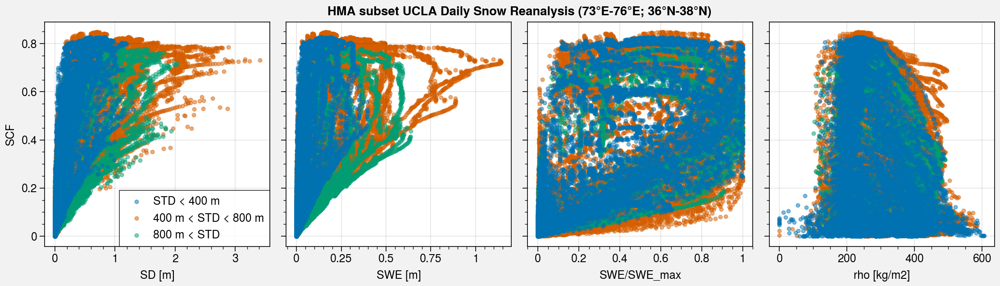

In [84]:
x = scf_regrid
y = [sd_regrid, swe_regrid, (swe_regrid/swe_regrid.max('time')), swe_regrid/sd_regrid*1000]

xlabel = ['SD [m]', 'SWE [m]', 'SWE/SWE_max', 'rho [kg/m2]']
cond = [(elevation_std < 400), (elevation_std > 400) & (elevation_std < 800), (elevation_std > 800)]
label = ['STD < 400 m', '400 m < STD < 800 m', '800 m < STD']
zorder = [3, 1, 2]

fig, axs = plot.subplots(ncols=len(y), sharex=0)

for i, ax in enumerate(axs):
    for c, z, l in zip(cond, zorder, label):
        ax.scatter(y[i].where(c).values.flatten(), x.where(c).values.flatten(), marker='.', alpha=0.5, zorder=z, label=l)
    ax.format(ylabel='SCF', xlabel=xlabel[i])
    
    if i == 0:
        ax.legend(ncols=1)
        
axs.format(
    suptitle='HMA subset UCLA Daily Snow Reanalysis (73°E-76°E; 36°N-38°N)'
)

# fig.save('img/SD_SWE_vs_SCF_subset.jpg')

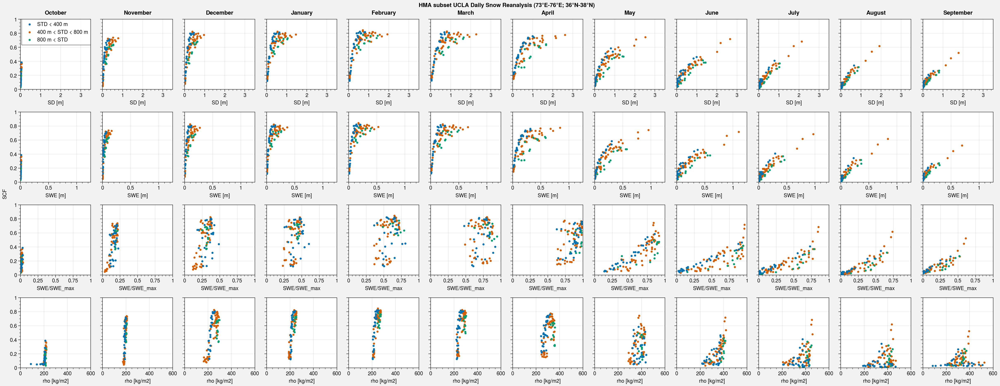

In [87]:
x = scf_regrid.groupby('time.month').mean('time')
y = [
    sd_regrid.groupby('time.month').mean('time'), 
    swe_regrid.groupby('time.month').mean('time'), 
    (swe_regrid.groupby('time.month').mean('time')/swe_regrid.max('time')), 
    swe_regrid.groupby('time.month').mean('time')/sd_regrid.groupby('time.month').mean('time')*1000
]
xlim = [(0, 3.5), (0, 1.25), (0, 1), (0, 600)]

xlabel = ['SD [m]', 'SWE [m]', 'SWE/SWE_max', 'rho [kg/m2]']
cond = [(elevation_std < 400), (elevation_std > 400) & (elevation_std < 800), (elevation_std > 800)]
label = ['STD < 400 m', '400 m < STD < 800 m', '800 m < STD']
zorder = [3, 1, 2]
months = [10, 11, 12, 1, 2, 3, 4, 5, 6, 7, 8, 9]

fig, axs = plot.subplots(nrows=len(y) , ncols=len(months), sharex=0, axwidth=1.7)

k = 0
for var, xl, xlab in zip(y, xlim, xlabel):
    for month in months:
        for c, z, l in zip(cond, zorder, label):
            axs[k].scatter(var.sel(month=month).where(c).values.flatten(), x.sel(month=month).where(c).values.flatten(), marker='.', alpha=1, zorder=z, label=l)
            axs[k].format(xlim=xl , ylim=(0,1), ylabel='SCF', xlabel=xlab)
        k += 1
        
axs[0].legend(ncols=1)   
        
axs.format(
    suptitle='HMA subset UCLA Daily Snow Reanalysis (73°E-76°E; 36°N-38°N)',
    collabels=[cld.month_name[m] for m in months],
)

# fig.save('img/SD_SWE_vs_SCF_subset_monthly.jpg')

## Make functions

In [9]:
def plot_SCF(x, ylabel, name, save=False):
    y = [sd_regrid, swe_regrid, (swe_regrid/swe_regrid.max('time')), swe_regrid/sd_regrid*1000]

    xlabel = ['SD [m]', 'SWE [m]', 'SWE/SWE_max', 'rho [kg/m2]']
    cond = [(elevation_std < 400), (elevation_std > 400) & (elevation_std < 800), (elevation_std > 800)]
    label = ['STD < 400 m', '400 m < STD < 800 m', '800 m < STD']
    zorder = [3, 1, 2]

    fig, axs = plot.subplots(ncols=len(y), sharex=0)

    for i, ax in enumerate(axs):
        for c, z, l in zip(cond, zorder, label):
            ax.scatter(y[i].where(c).values.flatten(), x.where(c).values.flatten(), marker='.', alpha=0.5, zorder=z, label=l)
        ax.format(ylabel=ylabel, xlabel=xlabel[i])

        if i == 0:
            ax.legend(ncols=1)

    axs.format(
        suptitle='HMA subset UCLA Daily Snow Reanalysis (73°E-76°E; 36°N-38°N)'
    )
    
    if save:
        fig.save('img/param_1_'+name+'_SD_SWE_vs_SCF_subset.jpg')

In [10]:
def plot_SCF_monthly(x, ylabel, name, save=False):
    x = x.groupby('time.month').mean('time')
    y = [
        sd_regrid.groupby('time.month').mean('time'), 
        swe_regrid.groupby('time.month').mean('time'), 
        (swe_regrid.groupby('time.month').mean('time')/swe_regrid.max('time')), 
        swe_regrid.groupby('time.month').mean('time')/sd_regrid.groupby('time.month').mean('time')*1000
    ]
    xlim = [(0, 3.5), (0, 1.25), (0, 1), (0, 600)]

    xlabel = ['SD [m]', 'SWE [m]', 'SWE/SWE_max', 'rho [kg/m2]']
    cond = [(elevation_std < 400), (elevation_std > 400) & (elevation_std < 800), (elevation_std > 800)]
    label = ['STD < 400 m', '400 m < STD < 800 m', '800 m < STD']
    zorder = [3, 1, 2]
    months = [10, 11, 12, 1, 2, 3, 4, 5, 6, 7, 8, 9]

    fig, axs = plot.subplots(nrows=len(y) , ncols=len(months), sharex=0, axwidth=1.7)

    k = 0
    for var, xl, xlab in zip(y, xlim, xlabel):
        for month in months:
            for c, z, l in zip(cond, zorder, label):
                axs[k].scatter(var.sel(month=month).where(c).values.flatten(), x.sel(month=month).where(c).values.flatten(), marker='.', alpha=1, zorder=z, label=l)
                axs[k].format(xlim=xl , ylim=(0,1), ylabel=ylabel, xlabel=xlab)
            k += 1

    axs[0].legend(ncols=1)   

    axs.format(
        suptitle='HMA subset UCLA Daily Snow Reanalysis (73°E-76°E; 36°N-38°N)',
        collabels=[cld.month_name[m] for m in months],
    )
    
    if save:
        fig.save('img/param_2_'+name+'_SD_SWE_vs_SCF_subset_monthly.jpg')

In [11]:
def plot_bias(scf, suptitle, title, save=False):  
    fig, axs = plot.subplots(ncols=4, nrows=3, axwidth=1.5, aspect=1.5)

    levels = plot.arange(0,1,0.05)

    param = scf.groupby('time.season').mean('time')
    obs = scf_regrid.groupby('time.season').mean('time')
    
    k = 0
    for season in (['SON', 'DJF', 'MAM', 'JJA']):
        m1 = axs[k].pcolormesh(obs.sel(season=season), cmap='viridis', levels=levels)
        k += 1
        
    for season in (['SON', 'DJF', 'MAM', 'JJA']):
        axs[k].pcolormesh(param.sel(season=season), cmap='viridis', levels=levels)
        k += 1
        
    for season in (['SON', 'DJF', 'MAM', 'JJA']):
        bias = (param-obs).sel(season=season)
        m2 = axs[k].pcolormesh(bias, cmap='RdBu', levels=plot.arange(-0.5,0.5,0.1), extend='both')
        axs[k].format(
            ultitle='RMSE = {:0.2f} %'.format((np.sqrt(u.spatial_average((bias**2))).values*100))
#             ultitle='{:0.2f} %'.format((np.sqrt(np.sum((bias**2))/bias.size).values*100))
        )
        k += 1

    fig.colorbar(m1, label='SCF', rows=(1, 2))
    fig.colorbar(m2, label='SCF bias', row=3)
    
    axs.format(
        rowlabels=['Observation\n(UCLA)', 'Param\n('+title+')', 'Param - Obs'],
        collabels=['SON', 'DJF', 'MAM', 'JJA'],
        suptitle=suptitle
    )
    
    if save:
        fig.save('img/param_3_'+title+'_bias.jpg')

## Snow cover comparisons

In [169]:
obs = xr.open_mfdataset(root_data_path+'MODIS/MOD10CM/netcdf/*.nc', combine='by_coords').sel(
    lat=slice(latlim_ext.stop, latlim_ext.start), 
    lon=lonlim_ext, time='2000').Snow_Cover_Monthly_CMG
modis = obs.where(obs <= 100)

In [144]:
snow_cci = xr.open_dataarray(
    root_data_path+'esacci/ESA_CCI_snow_SCFG_v1.0_HKH_gapfilled_monthly/ESACCI-L3C_SNOW-SCFG-AVHRR_MERGED-fv1.0_HKH_gapfilled_montlhy_1982-2014.nc'
).sel(time='2000')

In [159]:
UCLA_seas = scf.groupby('time.season').mean('time')*100
modis_seas = modis.sel(lat=slice(38,36), lon=slice(73,76)).groupby('time.season').mean('time')
snow_cci_seas = snow_cci.sel(lat=slice(38,36), lon=slice(73,76)).groupby('time.season').mean('time')

scf_list = [UCLA_seas.load(), modis_seas.load(), snow_cci_seas.load()]

/home/lalandmi/miniconda3/envs/phd_v3/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/lalandmi/miniconda3/envs/phd_v3/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


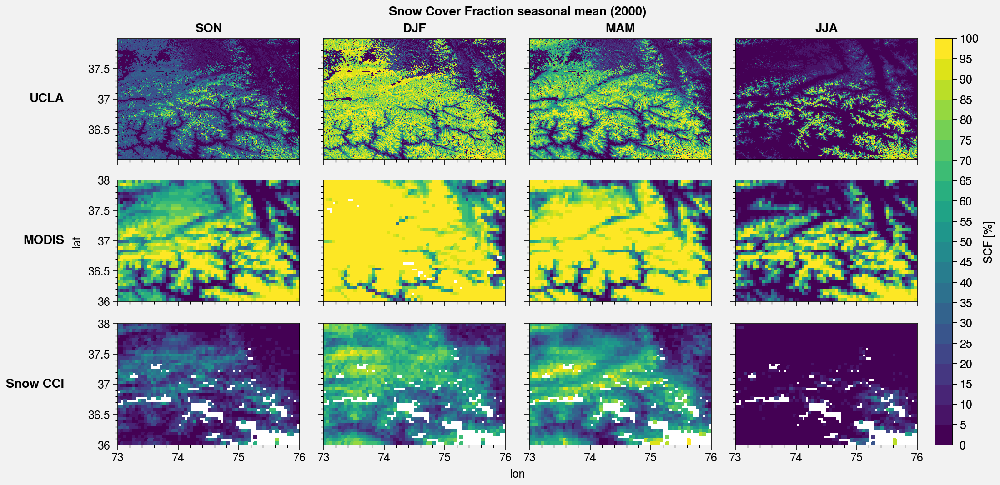

In [171]:
fig, axs = plot.subplots(ncols=4, nrows=3, axwidth=2, aspect=1.5)

k = 0
for s in scf_list:
    for season in (['SON', 'DJF', 'MAM', 'JJA']):
        m = axs[k].pcolormesh(s.sel(season=season), cmap='viridis', levels=plot.arange(0,100, 5))
        k += 1
        
fig.colorbar(m, label='SCF [%]')
        
axs.format(
    collabels=['SON', 'DJF', 'MAM', 'JJA'],
    rowlabels=['UCLA', 'MODIS', 'Snow CCI'],
    suptitle='Snow Cover Fraction seasonal mean (2000)'
)

fig.save('img/scf_comparison_subset_2000.jpg')

In [177]:
UCLA_mon = scf.groupby('time.month').mean('time')*100
modis_mon = modis.sel(lat=slice(38,36), lon=slice(73,76)).groupby('time.month').mean('time')
snow_cci_mon = snow_cci.sel(lat=slice(38,36), lon=slice(73,76)).groupby('time.month').mean('time')

scf_list = [UCLA_mon.load(), modis_mon.load(), snow_cci_mon.load()]

/home/lalandmi/miniconda3/envs/phd_v3/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/home/lalandmi/miniconda3/envs/phd_v3/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


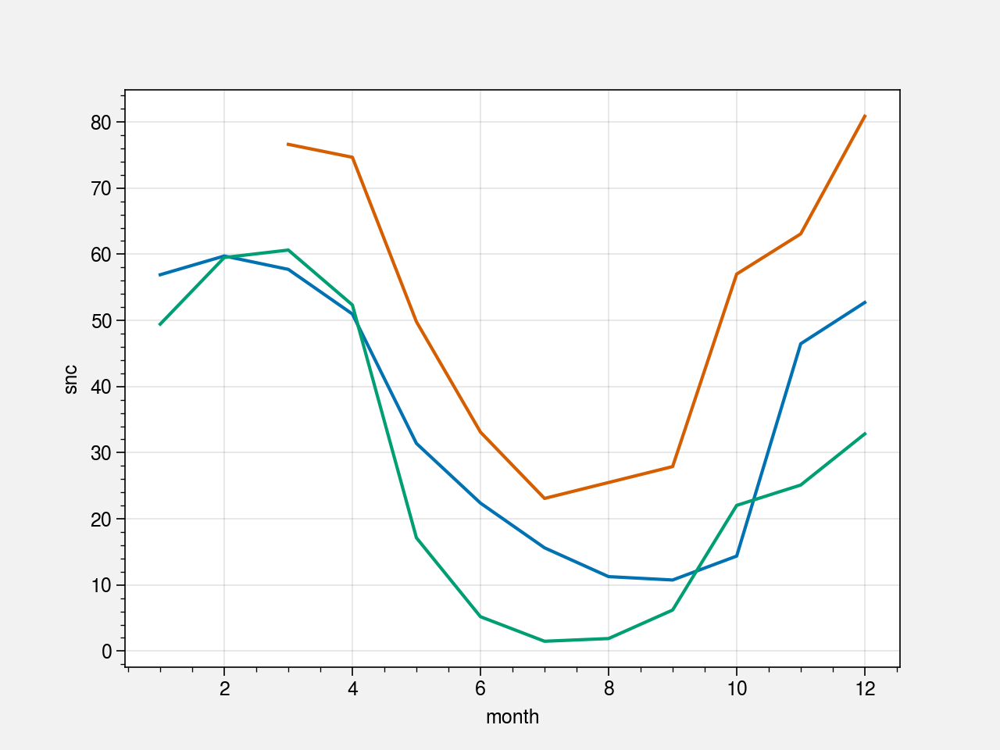

In [178]:
# /!\ on n'a pas exactement les mêmes mois/années car UCLA oct 1999 - sept 2000 et j'ai pris seulement 2000 pour les autres produits
for s in scf_list:
    s.mean(('lat','lon')).plot()

## Check Niu and Yan 2007

In [12]:
def NY07(sd, z0, rho_snow, rho_new, m):
    return np.tanh(sd/(2.5*z0*(rho_snow/rho_new)**m))

In [13]:
scf_NY07_orig = NY07(sd_regrid, 0.01, swe_regrid/sd_regrid*1000, 100, 1.6)
scf_NY07_orch = NY07(sd_regrid, 0.01, swe_regrid/sd_regrid*1000, 50, 1)

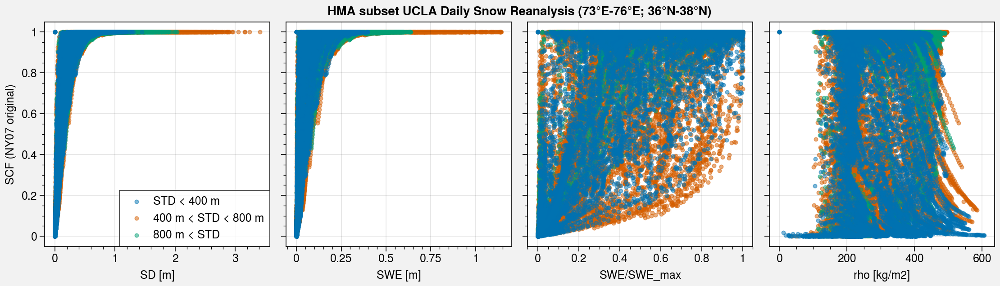

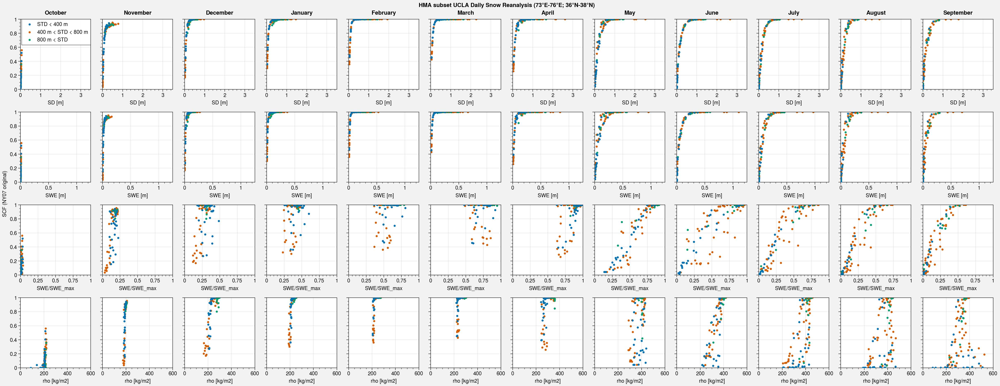

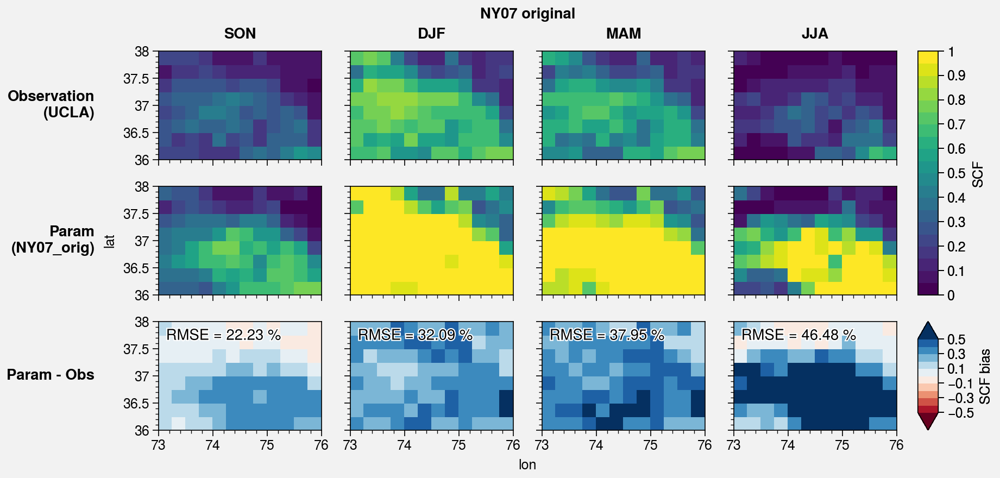

In [51]:
scf_param = scf_NY07_orig
label = 'NY07_orig'
name = 'NY07 original'
save = True

plot_SCF(scf_param, 'SCF ('+name+')', label, save=save)
plot_SCF_monthly(scf_param, 'SCF ('+name+')', label, save=save)
plot_bias(scf_param, name, label, save=save)

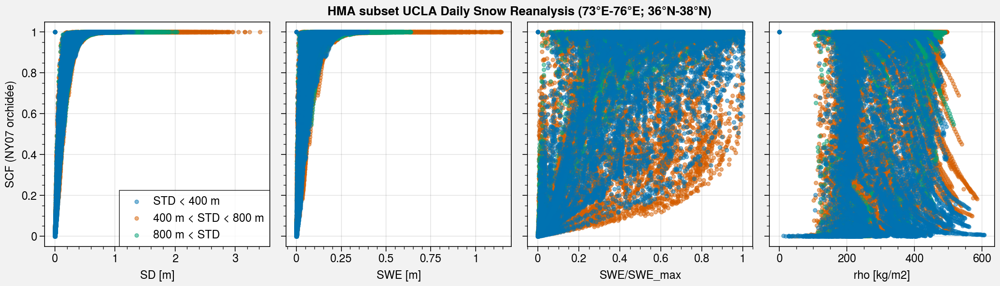

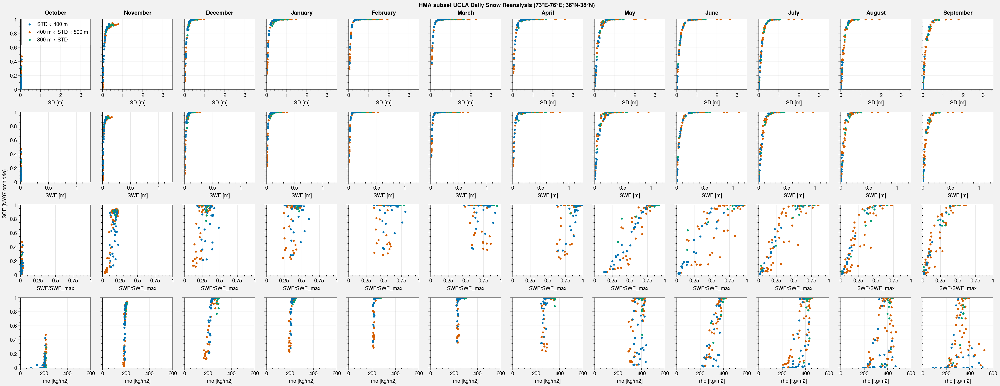

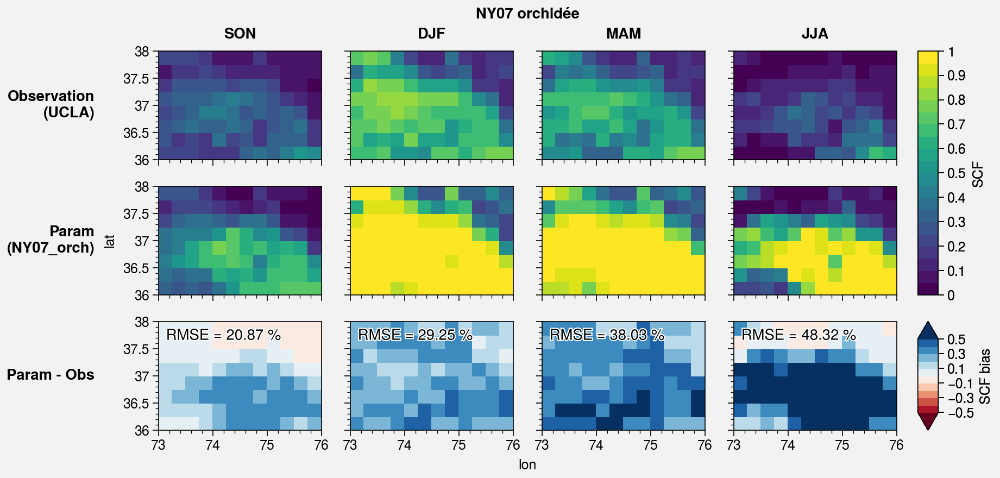

In [52]:
scf_param = scf_NY07_orch
label = 'NY07_orch'
name = 'NY07 orchidée'
save = True

plot_SCF(scf_param, 'SCF ('+name+')', label, save=save)
plot_SCF_monthly(scf_param, 'SCF ('+name+')', label, save=save)
plot_bias(scf_param, name, label, save=save)

## Optimize
https://stackoverflow.com/questions/13670333/multiple-variables-in-scipys-optimize-minimize

In [77]:
# https://stackoverflow.com/questions/13670333/multiple-variables-in-scipys-optimize-minimize

import scipy.optimize as optimize

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    z0, rho_new, m = params # <-- for readability you may wish to assign names to the component variables
    
    # rmse doesn't work... 
    # I don't know what method to use... I keep the default one here
#     mse = np.sum((np.tanh(sd_regrid/(2.5*z0*(swe_regrid/sd_regrid*1000/rho_new)**m)) - scf_regrid)**2)/scf_regrid.size
    mse = np.sum((NY07(sd_regrid, z0, swe_regrid/sd_regrid*1000, rho_new, m) - scf_regrid)**2)/scf_regrid.size
    
    return mse

initial_guess = [0.01, 50, 1]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
    print('MSE = {:0.3f}'.format(result.fun) + ' / RMSE = {:0.3f}'.format(np.sqrt(result.fun)) + ' ({:0.1f} %)'.format(np.sqrt(result.fun)*100))
else:
    raise ValueError(result.message)

[4.39022129e-03 4.99987644e+01 2.46629896e+00]
MSE = 0.019 / RMSE = 0.139 (13.9 %)


In [72]:
initial_guess = [0.01, 100, 1.6]
mse = (f(initial_guess)).values
print('MSE = {:0.3f}'.format(mse) + ' / RMSE = {:0.3f}'.format(np.sqrt(mse)) + ' ({:0.1f} %)'.format(np.sqrt(mse)*100))

MSE = 0.149 / RMSE = 0.386 (38.6 %)


In [73]:
initial_guess = [0.01, 50, 1]
mse = (f(initial_guess)).values
print('MSE = {:0.3f}'.format(mse) + ' / RMSE = {:0.3f}'.format(np.sqrt(mse)) + ' ({:0.1f} %)'.format(np.sqrt(mse)*100))

MSE = 0.146 / RMSE = 0.383 (38.3 %)


Diminution de ~38% -> 14%

In [78]:
initial_guess = [0.01, 100, 1.6]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
    print('MSE = {:0.3f}'.format(result.fun) + ' / RMSE = {:0.3f}'.format(np.sqrt(result.fun)) + ' ({:0.1f} %)'.format(np.sqrt(result.fun)*100))
else:
    raise ValueError(result.message)

[2.42691772e-02 1.00008946e+02 2.46626450e+00]
MSE = 0.019 / RMSE = 0.139 (13.9 %)


2 solution équivalentes :
- z0 = 0.0044 (4.4 mm), rho_new = 50 kg/m3, m = 2.47
- z0 = 0.0243 (2.4 cm), rho_new = 100 kg/m3, m = 2.47

In [14]:
scf_NY07_opti = NY07(sd_regrid, 0.0044, swe_regrid/sd_regrid*1000, 50, 2.47)

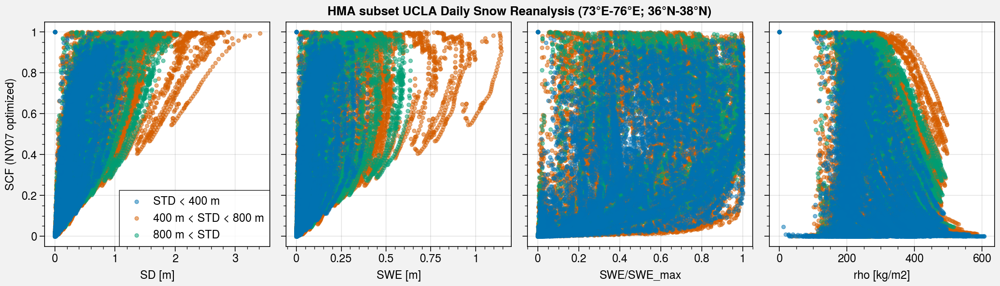

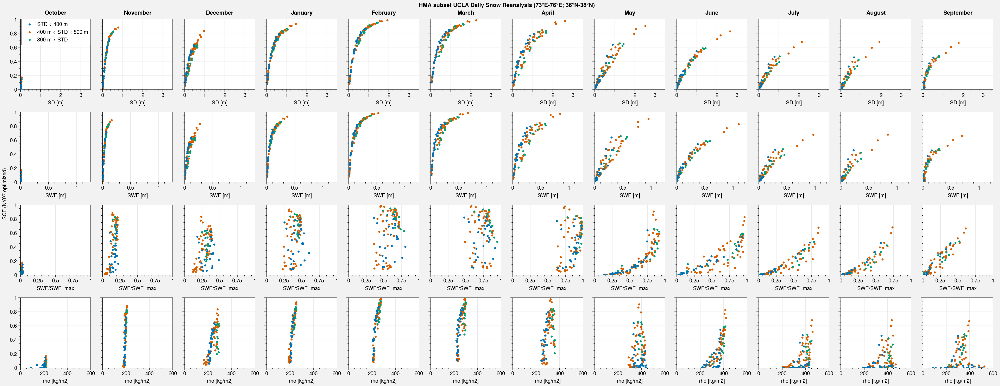

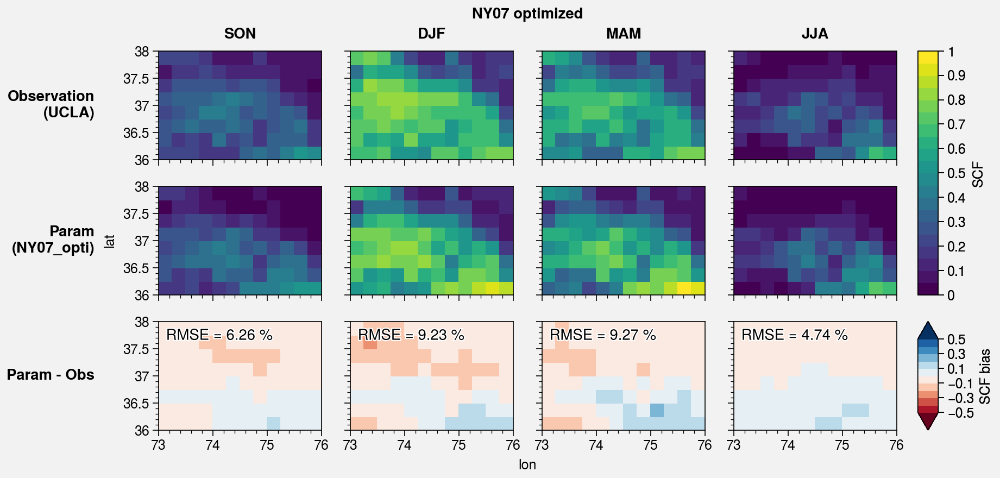

In [80]:
scf_param = scf_NY07_opti
label = 'NY07_opti'
name = 'NY07 optimized'
save = True

plot_SCF(scf_param, 'SCF ('+name+')', label, save=save)
plot_SCF_monthly(scf_param, 'SCF ('+name+')', label, save=save)
plot_bias(scf_param, name, label, save=save)

## NY07 custom (with STD)

In [15]:
def NY07_custom(sd, z0, rho_snow, rho_new, m, zstd, zstd_0):
    return np.tanh(sd/(2.5*z0*(rho_snow/rho_new*(1+zstd/zstd_0))**m))

In [140]:
# https://stackoverflow.com/questions/13670333/multiple-variables-in-scipys-optimize-minimize

import scipy.optimize as optimize

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    z0, rho_new, m, zstd_0 = params # <-- for readability you may wish to assign names to the component variables
    
    # rmse doesn't work... 
    # I don't know what method to use... I keep the default one here
#     mse = np.sum((np.tanh(sd_regrid/(2.5*z0*(swe_regrid/sd_regrid*1000/rho_new)**m)) - scf_regrid)**2)/scf_regrid.size
    mse = np.sum((NY07_custom(sd_regrid, z0, swe_regrid/sd_regrid*1000, rho_new, m, elevation_std_subset, zstd_0) - scf_regrid)**2)/scf_regrid.size
    
    return mse

initial_guess = [0.044, 50, 2.47, 200]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
    print('MSE = {:0.3f}'.format(result.fun) + ' / RMSE = {:0.3f}'.format(np.sqrt(result.fun)) + ' ({:0.1f} %)'.format(np.sqrt(result.fun)*100))
else:
    raise ValueError(result.message)

[3.43944050e-03 4.91636598e+01 2.23622374e+00 1.81589172e+03]
MSE = 0.017 / RMSE = 0.131 (13.1 %)


In [16]:
scf_NY07_cust = NY07_custom(sd_regrid, 3.43944050e-03, swe_regrid/sd_regrid*1000, 4.91636598e+01, 2.23622374e+00, elevation_std_subset, 1.81589172e+03)

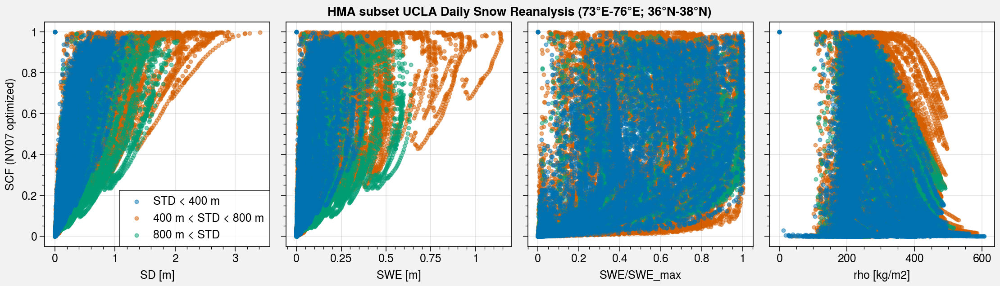

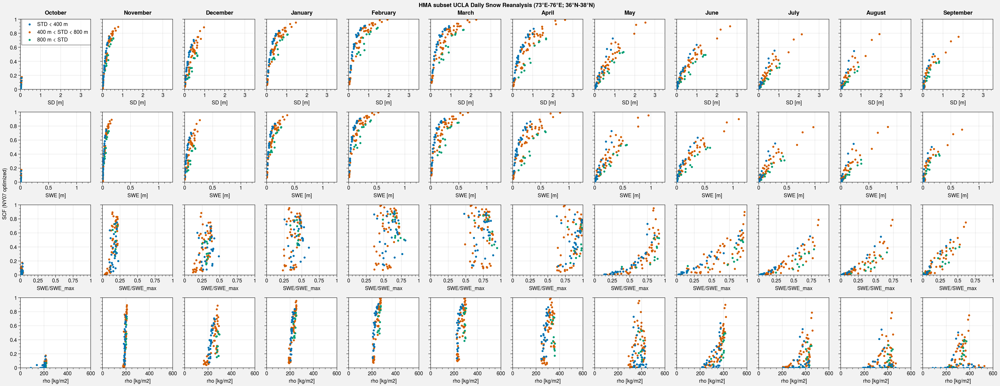

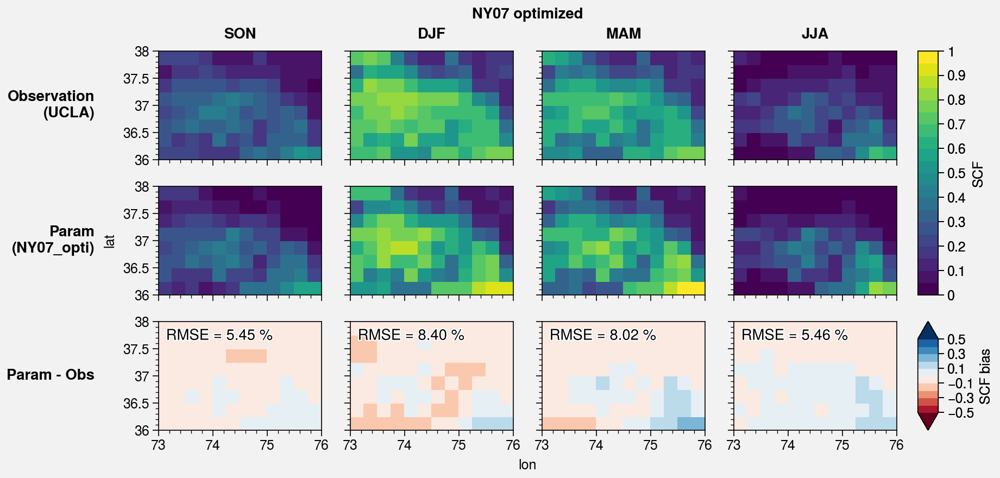

In [142]:
scf_param = NY07_custom(sd_regrid, 3.43944050e-03, swe_regrid/sd_regrid*1000, 4.91636598e+01, 2.23622374e+00, elevation_std_subset, 1.81589172e+03)
label = 'NY07_opti'
name = 'NY07 optimized'
save = False

plot_SCF(scf_param, 'SCF ('+name+')', label, save=save)
plot_SCF_monthly(scf_param, 'SCF ('+name+')', label, save=save)
plot_bias(scf_param, name, label, save=save)

In [22]:
def NY07_custom_2(sd, z0, rho_snow, rho_new, m, zstd, zstd_0, alpha):
    return (1-alpha)*np.tanh(sd/(2.5*z0*(rho_snow/rho_new*(1+zstd/zstd_0))**m))

In [156]:
# https://stackoverflow.com/questions/13670333/multiple-variables-in-scipys-optimize-minimize

import scipy.optimize as optimize

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    z0, rho_new, m, zstd_0, alpha = params # <-- for readability you may wish to assign names to the component variables
    
    # rmse doesn't work... 
    # I don't know what method to use... I keep the default one here
#     mse = np.sum((np.tanh(sd_regrid/(2.5*z0*(swe_regrid/sd_regrid*1000/rho_new)**m)) - scf_regrid)**2)/scf_regrid.size
    mse = np.sum((NY07_custom(sd_regrid, z0, swe_regrid/sd_regrid*1000, rho_new, m, elevation_std_subset, zstd_0, alpha) - scf_regrid)**2)/scf_regrid.size
    
    return mse

# initial_guess = [0.044, 50, 2.47, 200, -0.2]
initial_guess = [3.43944050e-03, 4.91636598e+01, 2.23622374e+00, 1.81589172e+03, -0.2]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
    print('MSE = {:0.3f}'.format(result.fun) + ' / RMSE = {:0.3f}'.format(np.sqrt(result.fun)) + ' ({:0.1f} %)'.format(np.sqrt(result.fun)*100))
else:
    raise ValueError(result.message)

[1.05299774e-03 4.91705751e+01 2.49499081e+00 1.81589173e+03
 2.84240253e-01]
MSE = 0.011 / RMSE = 0.104 (10.4 %)


In [25]:
z0, rho_new, m, zstd_0, alpha = [1.05299774e-03, 4.91705751e+01, 2.49499081e+00, 1.81589173e+03, 2.84240253e-01]

scf_NY07_cust2 = NY07_custom_2(sd_regrid, z0, swe_regrid/sd_regrid*1000, rho_new, m, elevation_std_subset, zstd_0, alpha)

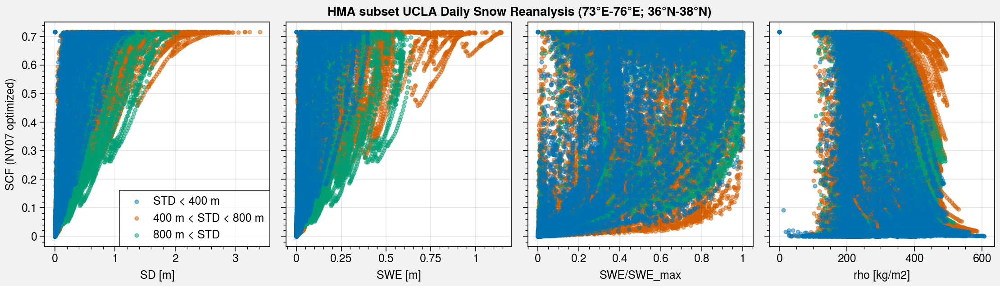

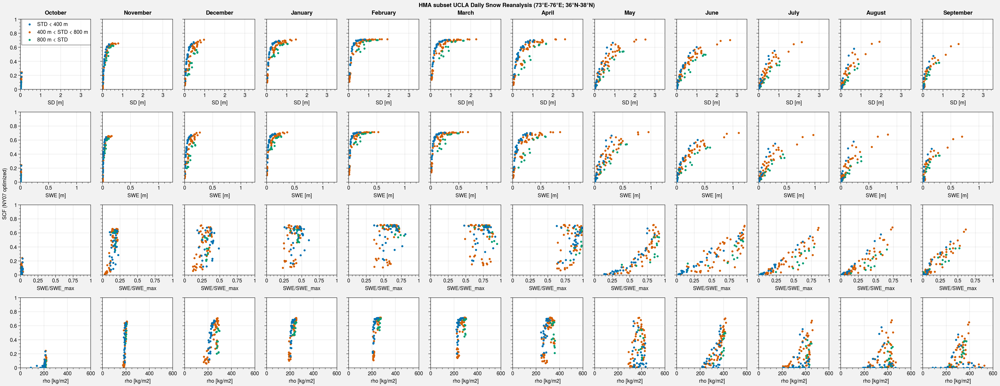

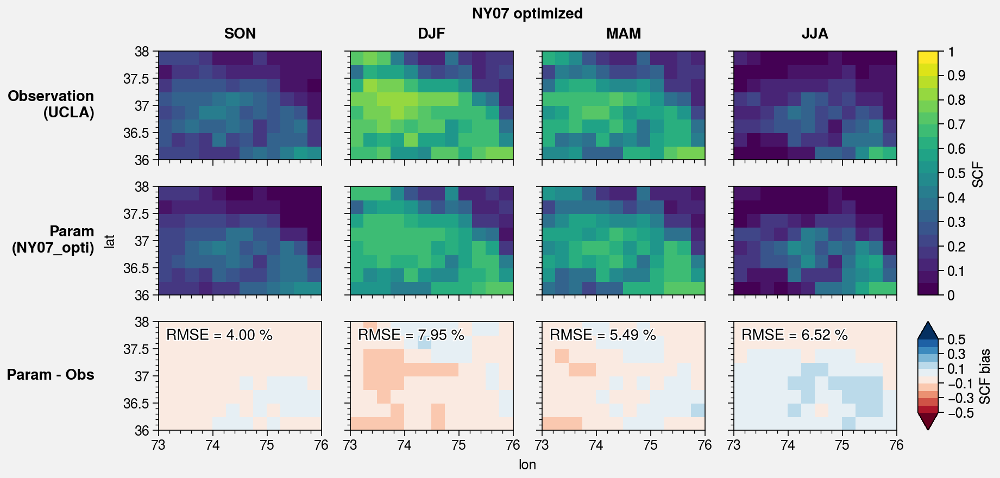

In [157]:
z0, rho_new, m, zstd_0, alpha = [1.05299774e-03, 4.91705751e+01, 2.49499081e+00, 1.81589173e+03, 2.84240253e-01]

scf_param = NY07_custom(sd_regrid, z0, swe_regrid/sd_regrid*1000, rho_new, m, elevation_std_subset, zstd_0, alpha)
label = 'NY07_opti'
name = 'NY07 optimized'
save = False

plot_SCF(scf_param, 'SCF ('+name+')', label, save=save)
plot_SCF_monthly(scf_param, 'SCF ('+name+')', label, save=save)
plot_bias(scf_param, name, label, save=save)

## Roesch et al. 2001

In [50]:
def R01(SWE, eps, zstd):
    return 0.95 * np.tanh(100*SWE) * np.sqrt( 1000*SWE / ( 1000*SWE + eps + 0.15*zstd) )

In [51]:
scf_R01 = R01(swe_regrid, 1e-6, elevation_std_subset)

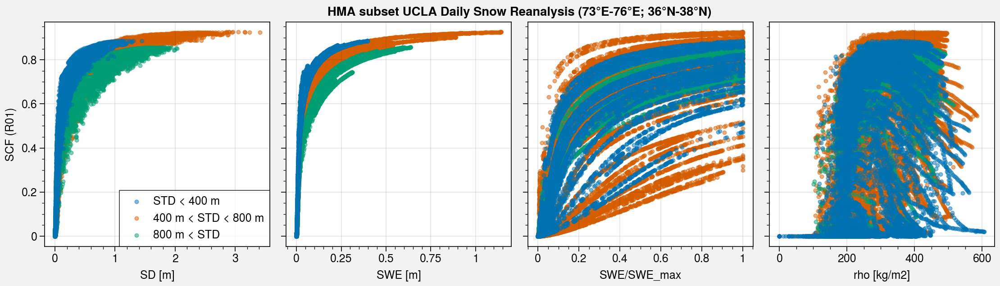

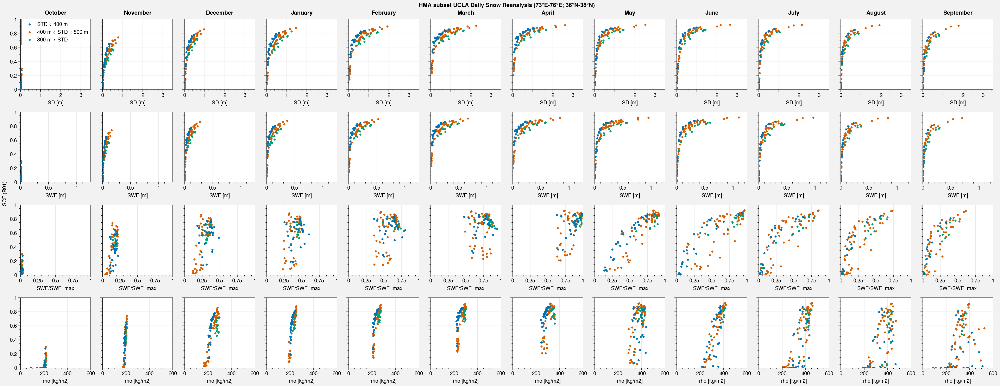

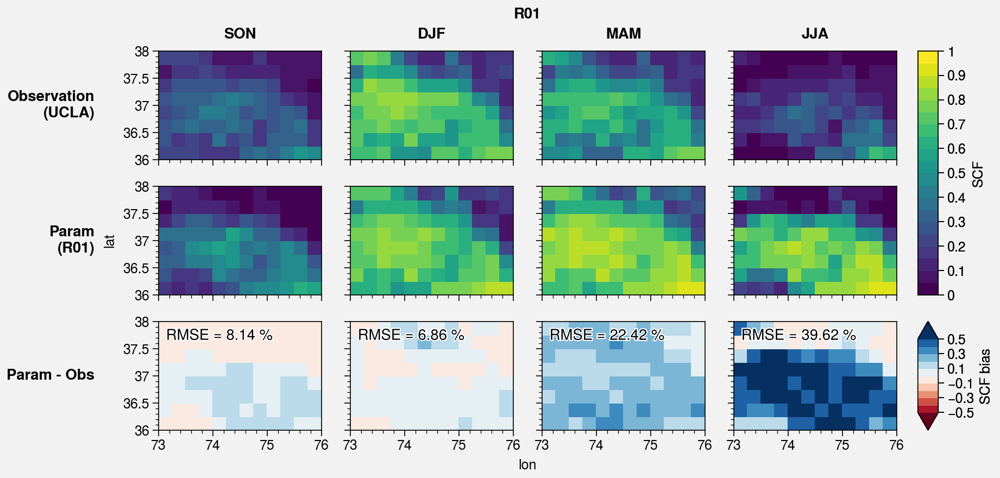

In [52]:
scf_param = scf_R01
label = 'R01'
name = 'R01'
save = False

plot_SCF(scf_param, 'SCF ('+name+')', label, save=save)
plot_SCF_monthly(scf_param, 'SCF ('+name+')', label, save=save)
plot_bias(scf_param, name, label, save=save)

In [31]:
def R01_opti(SWE, eps, zstd, alpha, a, b):
    return alpha * np.tanh(a*SWE) * np.sqrt( 1000*SWE / ( 1000*SWE + eps + b*zstd) )

In [32]:
# https://stackoverflow.com/questions/13670333/multiple-variables-in-scipys-optimize-minimize

import scipy.optimize as optimize

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    eps, alpha, a, b = params # <-- for readability you may wish to assign names to the component variables
    
    # rmse doesn't work... 
    # I don't know what method to use... I keep the default one here
#     mse = np.sum((np.tanh(sd_regrid/(2.5*z0*(swe_regrid/sd_regrid*1000/rho_new)**m)) - scf_regrid)**2)/scf_regrid.size
    mse = np.sum((R01_opti(swe_regrid, eps, elevation_std_subset, alpha, a, b) - scf_regrid)**2)/scf_regrid.size
    
    return mse

initial_guess = [1e-6, 0.95, 100, 0.15]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
    print('MSE = {:0.3f}'.format(result.fun) + ' / RMSE = {:0.3f}'.format(np.sqrt(result.fun)) + ' ({:0.1f} %)'.format(np.sqrt(result.fun)*100))
else:
    raise ValueError(result.message)

[-1.32074358e-04  7.01853146e-01  1.00000567e+02  2.21673164e-01]
MSE = 0.035 / RMSE = 0.186 (18.6 %)


In [33]:
scf_R01_opti = R01_opti(swe_regrid, -1.32e-4, elevation_std_subset, 0.7, 100, 0.22)

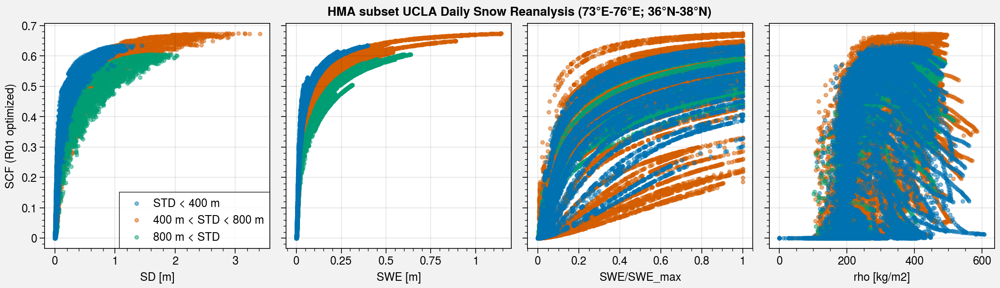

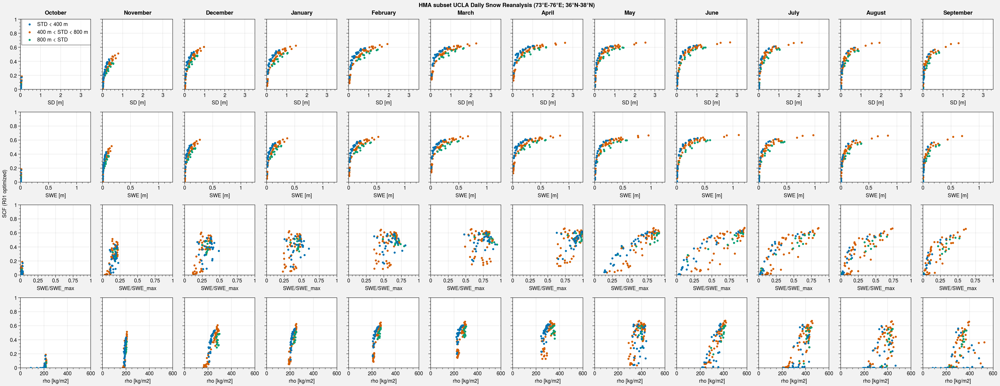

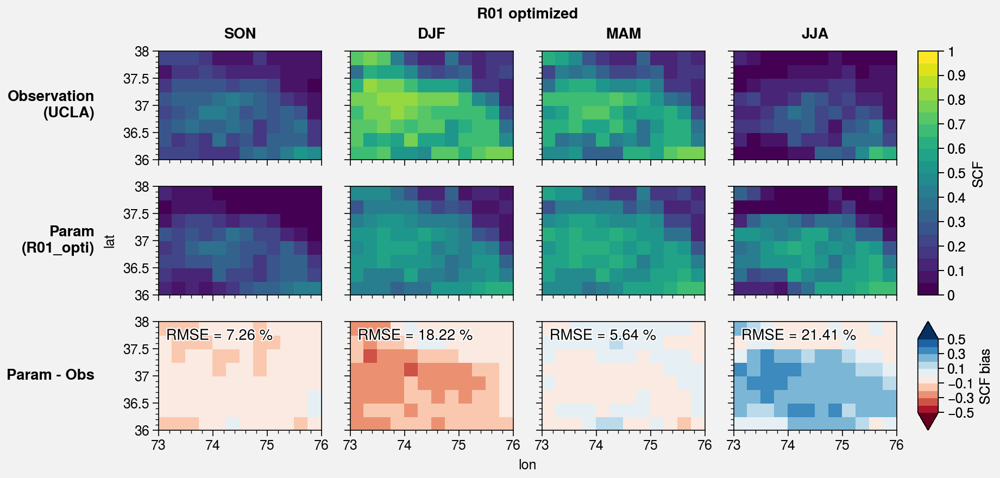

In [36]:
scf_param = scf_R01_opti
label = 'R01_opti'
name = 'R01 optimized'
save = True

plot_SCF(scf_param, 'SCF ('+name+')', label, save=save)
plot_SCF_monthly(scf_param, 'SCF ('+name+')', label, save=save)
plot_bias(scf_param, name, label, save=save)

## Check time series

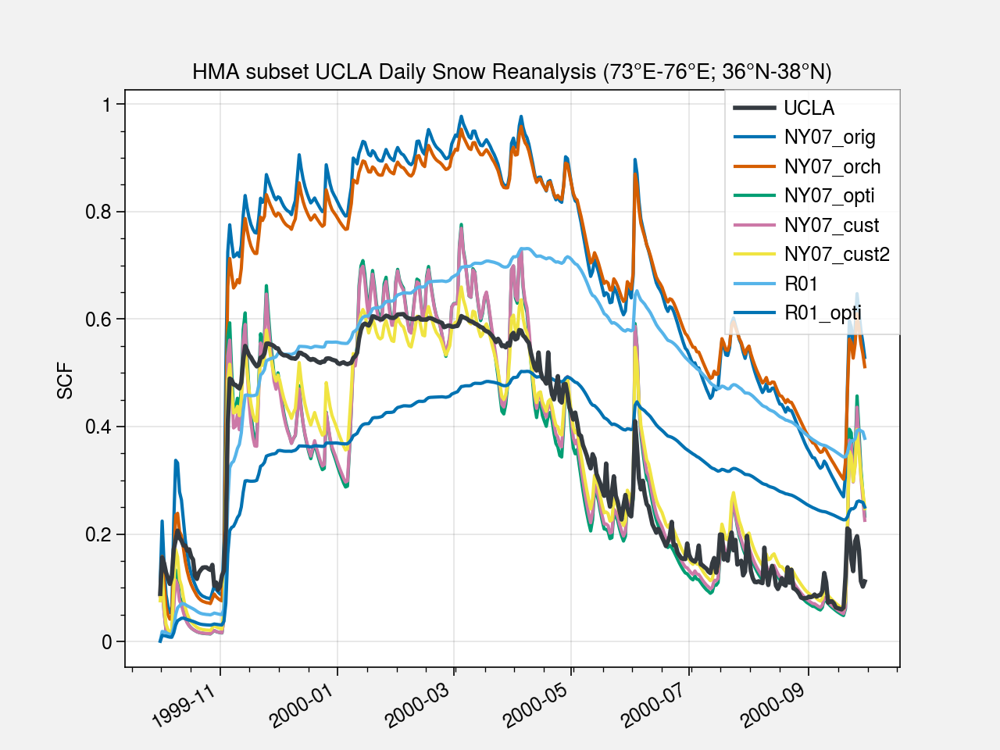

In [46]:
plt.figure()

scf_regrid.mean(('lat', 'lon')).plot(label='UCLA', color='gray8', linewidth=2, zorder=10)
scf_NY07_orig.mean(('lat', 'lon')).plot(label='NY07_orig')
scf_NY07_orch.mean(('lat', 'lon')).plot(label='NY07_orch')
scf_NY07_opti.mean(('lat', 'lon')).plot(label='NY07_opti')
scf_NY07_cust.mean(('lat', 'lon')).plot(label='NY07_cust')
scf_NY07_cust2.mean(('lat', 'lon')).plot(label='NY07_cust2')
scf_R01.mean(('lat', 'lon')).plot(label='R01')
scf_R01_opti.mean(('lat', 'lon')).plot(label='R01_opti')

plt.ylabel('SCF')
plt.xlabel('')
plt.title('HMA subset UCLA Daily Snow Reanalysis (73°E-76°E; 36°N-38°N)')

plt.legend()

plt.savefig('img/1999-2000_subset_timeseries_HMA_UCLA_params.jpg')